# Bounding-Box Experiment - Fashion Editing
The purpose of this experiment is to see how far we can push improvement in our fine-tuned fashion editing model. We want to see to what extent we can address some of the visual issues we are detecting in its edit - the most prevelant one being that it's editing outside the segmentation mask area. We want to confine the editing region stricter, so we incorporate a "hierarchial bounding" into our loss function.

The general structure of this notebook file remains the same as original, titled "Final_Project".

# 1. Imports and Background

In [ ]:
# imports
import os
import json
import torch
from torch import nn
from torch.utils.data import DataLoader
import torch.nn.functional as F
import numpy as np
import PIL
from PIL import Image
import matplotlib.pyplot as plt
from tqdm import tqdm
from tqdm.auto import tqdm
import pandas as pd
import requests
from io import BytesIO
import random

# models and dataset
from datasets import load_dataset
from diffusers import StableDiffusionInstructPix2PixPipeline, DPMSolverMultistepScheduler
from transformers import CLIPProcessor, CLIPModel
from datasets import load_dataset

In [ ]:
# cloning pix2pix, getting it in

!git clone https://github.com/huggingface/diffusers

%cd examples/instruct_pix2pix
!pip install -r requirements.txt

Cloning into 'diffusers'...
remote: Enumerating objects: 112237, done.
remote: Counting objects: 100% (380/380), done.
remote: Compressing objects: 100% (249/249), done.
remote: Total 112237 (delta 278), reused 131 (delta 131), pack-reused 111857 (from 3)
Receiving objects: 100% (112237/112237), 85.66 MiB | 36.29 MiB/s, done.
Resolving deltas: 100% (83646/83646), done.
[Errno 2] No such file or directory: 'examples/instruct_pix2pix'
/content
ERROR: Could not open requirements file: [Errno 2] No such file or directory: 'requirements.txt'


In [ ]:
# from pix2pix hf website

import PIL
import requests
import torch
from diffusers import StableDiffusionInstructPix2PixPipeline, EulerAncestralDiscreteScheduler
from accelerate.utils import write_basic_config
write_basic_config()

PosixPath('/root/.cache/huggingface/accelerate/default_config.yaml')

# 2. Data Preparation

In [ ]:
#Loading fashionpedia
dataset_fashionpedia = load_dataset("detection-datasets/fashionpedia", split="train", streaming=True)
fashionpedia_samples = list(dataset_fashionpedia.take(100)) #just load 100 for now to see if possible
print(fashionpedia_samples[0]['image'])


#Define clip model to help us evaluate models
clip_model = CLIPModel.from_pretrained("openai/clip-vit-large-patch14").to("cuda")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-large-patch14")

README.md: 0.00B [00:00, ?B/s]

dataset_infos.json: 0.00B [00:00, ?B/s]

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=682x1024 at 0x7C8E357395E0>


config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/1.71G [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/905 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

In [ ]:
#load deepfashion2
dataset = load_dataset("SaffalPoosh/deepFashion-with-masks")

print(dataset)
print(dataset["train"].features)

sample = dataset["train"][0]
print(sample.keys())


README.md:   0%|          | 0.00/836 [00:00<?, ?B/s]

data/train-00000-of-00004-ed3909a24b468f(…):   0%|          | 0.00/363M [00:00<?, ?B/s]

data/train-00001-of-00004-e2bb46ac3213d7(…):   0%|          | 0.00/364M [00:00<?, ?B/s]

data/train-00002-of-00004-f11f7b29a225c1(…):   0%|          | 0.00/361M [00:00<?, ?B/s]

data/train-00003-of-00004-e6de6e7287b28c(…):   0%|          | 0.00/361M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/40658 [00:00<?, ? examples/s]

DatasetDict({
    train: Dataset({
        features: ['images', 'gender', 'pose', 'cloth_type', 'pid', 'caption', 'mask', 'mask_overlay'],
        num_rows: 40658
    })
})
{'images': Image(mode=None, decode=True), 'gender': Value('string'), 'pose': Value('string'), 'cloth_type': Value('string'), 'pid': Value('string'), 'caption': Value('string'), 'mask': Image(mode=None, decode=True), 'mask_overlay': Image(mode=None, decode=True)}
dict_keys(['images', 'gender', 'pose', 'cloth_type', 'pid', 'caption', 'mask', 'mask_overlay'])


In [ ]:
#building triples from same person pairs

from collections import defaultdict

# Group images by person ID
by_pid = defaultdict(list)
for i in range(len(dataset["train"])):
  by_pid[dataset["train"][i]["pid"]].append(i)

multi_outfit = {k: v for k, v in by_pid.items() if len(v) >= 2}
print(f"Total unique people: {len(by_pid)}")
print(f"People with 2+ images: {len(multi_outfit)}")
print(f"Potential pairs: {sum(len(v) for v in multi_outfit.values())}")

Total unique people: 7557
People with 2+ images: 6900
Potential pairs: 40001


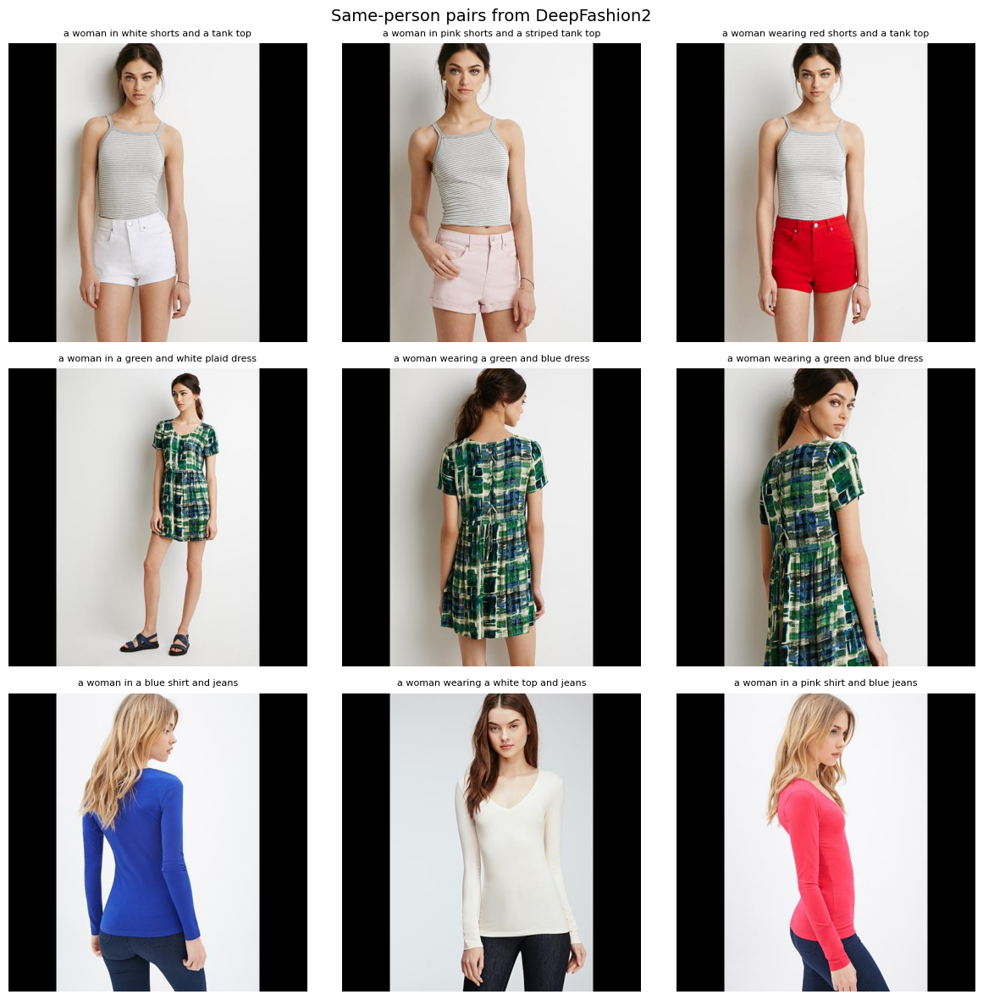

In [ ]:
# visualizing same person pairs

multi_outfit_pids = [pid for pid, indices in by_pid.items() if len(indices) >= 3]

fig, axes = plt.subplots(3, 3, figsize=(12, 12))
for row, pid in enumerate(multi_outfit_pids[:3]):
  indices = by_pid[pid][:3]
  for col, idx in enumerate(indices):
    sample = dataset["train"][idx]
    axes[row, col].imshow(sample["images"])
    axes[row, col].set_title(sample["caption"], fontsize=8)
    axes[row, col].axis("off")

plt.suptitle("Same-person pairs from DeepFashion2", fontsize=14)
plt.tight_layout()
plt.show()


In [ ]:
def generate_instruction(caption1, caption2):
  """Generate edit instruction from two captions."""
  part2 = caption2.lower().split("in ")[-1] if "in " in caption2.lower() else caption2.lower()
  return f"change to {part2}"

MAX_TRIPLETS = 8000

# Build triplets from same-person pairs
triplets = []
for pid, indices in tqdm(by_pid.items(), desc="Building triplets"):
  if len(indices) < 2:
      continue

  for i in range(len(indices)):
      for j in range(len(indices)):
          if i == j:
              continue

          triplets.append({
                  "src_idx": indices[i],
                  "tgt_idx": indices[j],
              })

          if len(triplets) >= MAX_TRIPLETS:
              break
      if len(triplets) >= MAX_TRIPLETS:
          break
  if len(triplets) >= MAX_TRIPLETS:
      break

print(f"Total triplets: {len(triplets)}")
print(f"Sample: {triplets[0]}")


Building triplets:   0%|          | 0/7557 [00:00<?, ?it/s]

Total triplets: 8000
Sample: {'src_idx': 0, 'tgt_idx': 11800}


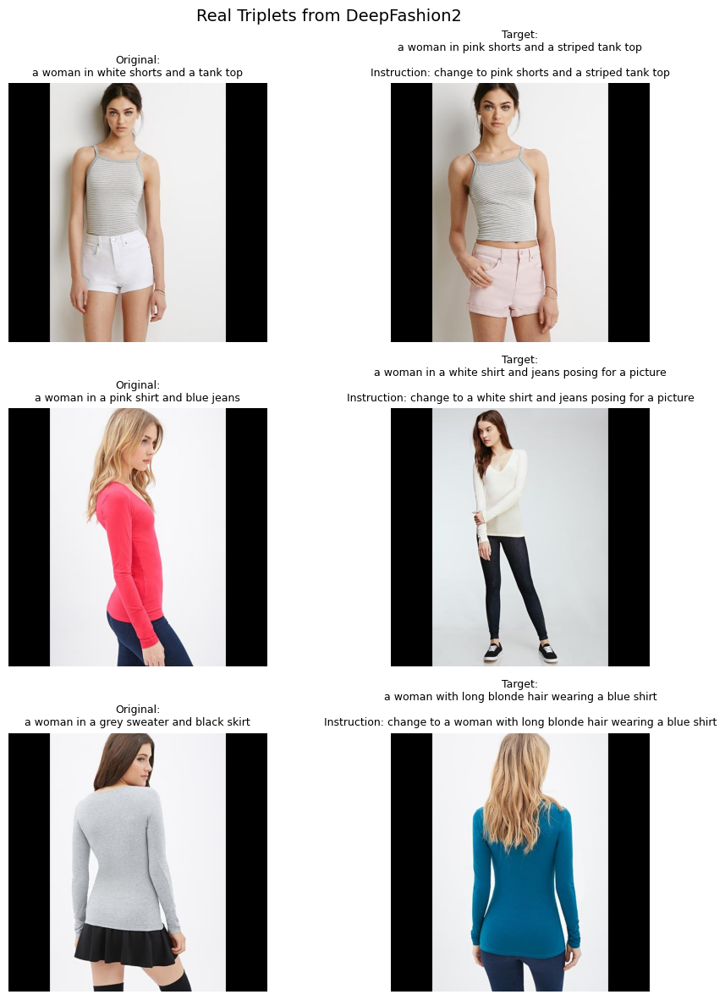

In [ ]:
# Visualize a few triplets
fig, axes = plt.subplots(3, 2, figsize=(10, 12))

for row in range(3):
    t = triplets[row * 100]  # Sample from different parts

    # Load images from dataset using indices
    src = dataset["train"][t["src_idx"]]
    tgt = dataset["train"][t["tgt_idx"]]
    instruction = generate_instruction(src["caption"], tgt["caption"])

    axes[row, 0].imshow(src["images"])
    axes[row, 0].set_title(f"Original:\n{src['caption']}", fontsize=9)
    axes[row, 0].axis("off")

    axes[row, 1].imshow(tgt["images"])
    axes[row, 1].set_title(f"Target:\n{tgt['caption']}\n\nInstruction: {instruction}", fontsize=9)
    axes[row, 1].axis("off")

plt.suptitle("Real Triplets from DeepFashion2", fontsize=14)
plt.tight_layout()
plt.show()

In [ ]:
import os
from tqdm import tqdm
from PIL import Image

CACHE_DIR = "deepfashion_cache"
os.makedirs(CACHE_DIR, exist_ok=True)

# Get unique indices we need
all_indices = set()
for t in triplets:
  all_indices.add(t["src_idx"])
  all_indices.add(t["tgt_idx"])

print(f"Caching {len(all_indices)} unique images...")

for idx in tqdm(all_indices, desc="Caching images"):
  cache_path = f"{CACHE_DIR}/{idx}.png"
  if not os.path.exists(cache_path):
      img = dataset["train"][idx]["images"]
      img.save(cache_path)

print("Caching complete!")


Caching 258 unique images...


Caching images: 100%|██████████| 258/258 [00:08<00:00, 31.36it/s]

Caching complete!


In [ ]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torchvision.transforms.functional as TF

class TripletDataset(Dataset):
    def __init__(self, triplet_list, hf_data, size=512):
        self.data = triplet_list
        self.hf = hf_data
        self.size = size
        self.transform = transforms.Compose([
            transforms.Resize((size, size), interpolation=transforms.InterpolationMode.BILINEAR),
            transforms.ToTensor(),
            transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
        ])

        self.mask_transform = transforms.Compose([
            transforms.Resize((size, size), interpolation=transforms.InterpolationMode.NEAREST),
            transforms.ToTensor(),
        ])
        # Mild color jitter shared between conditioning and target (helps generalization)
        self.color_jitter = transforms.ColorJitter(
            brightness=0.1,
            contrast=0.1,
            saturation=0.1,
            hue=0.05,
        )

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        t = self.data[idx]

        src = self.hf["train"][t["src_idx"]]
        tgt = self.hf["train"][t["tgt_idx"]]

        orig_img = src["images"]
        edit_img = tgt["images"]
        instruction = generate_instruction(src["caption"], tgt["caption"])
        src_mask = src["mask"]

        if orig_img.mode != "RGB":
            orig_img = orig_img.convert("RGB")
        if edit_img.mode != "RGB":
            edit_img = edit_img.convert("RGB")
        if src_mask.mode != "L":
          src_mask = src_mask.convert("L")

        if torch.rand(1).item() < 0.5:
            orig_img = TF.hflip(orig_img)
            edit_img = TF.hflip(edit_img)
            src_mask = TF.hflip(src_mask)

        # Mild color jitter applied consistently to both images (not the mask)
        orig_img = self.color_jitter(orig_img)
        edit_img = self.color_jitter(edit_img)

        conditioning_image = self.transform(orig_img)
        pixel_values = self.transform(edit_img)
        mask_tensor = self.mask_transform(src_mask)  # [1, H, W], values in [0,1]
        mask_tensor = (mask_tensor > 0.5).float()

        return {
            "conditioning_image": conditioning_image,
            "pixel_values": pixel_values,
            "prompt": instruction,
            "mask": mask_tensor,
        }

# Create dataset
full_ds = TripletDataset(triplets, dataset, size=512)

train_size = int(len(full_ds) * 0.8)
val_size = int(len(full_ds) * 0.1)
test_size = len(full_ds) - train_size - val_size

train_ds, val_ds, test_ds = torch.utils.data.random_split(
    full_ds,
    [train_size, val_size, test_size],
    generator=torch.Generator().manual_seed(42)
)

BATCH_SIZE = 1  # Small batch size
train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=0)
val_loader = DataLoader(val_ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=0)
test_loader = DataLoader(test_ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

print(f"Train: {len(train_ds)}, Val: {len(val_ds)}, Test: {len(test_ds)}")

test_batch = next(iter(train_loader))
print(f"Conditioning shape: {test_batch['conditioning_image'].shape}")
print(f"Sample prompt: {test_batch['prompt'][0]}")
print("DataLoader working!")

Train: 6400, Val: 800, Test: 800
Conditioning shape: torch.Size([1, 3, 512, 512])
Sample prompt: change to a man wearing a brown shirt and jeans
DataLoader working!


# 3. Model Preparation and Baseline

## 3.1 Calculating Clip Score and Directional Similarity Scores (Evaluation Metrics)


In [ ]:
#Define evaluation metrics

#clip score, which tells us how similar text is to image.
def calculate_clip_score(image, text, clip_model, clip_processor):
    """Author: David Thai -- function to calculate the clip score."""
    inputs = clip_processor(
        text=[text],
        images=image,
        return_tensors="pt",
        padding=True
    ).to("cuda")
    with torch.no_grad(): #the following is cosine similarity
        outputs = clip_model(**inputs)
        image_embeds = outputs.image_embeds / outputs.image_embeds.norm(dim=-1, keepdim=True)
        text_embeds = outputs.text_embeds / outputs.text_embeds.norm(dim=-1, keepdim=True)
        clip_score = (image_embeds @ text_embeds.T).item()
    return clip_score * 100



#directional simularity
def calculate_clip_directional_similarity(original_img, edited_img, text, clip_model, clip_processor):
   """Author: David Thai -- function to calculate the clip directional similarity"""
    with torch.no_grad():
        #original embeddings
        inputs_orig = clip_processor(images=original_img, return_tensors="pt").to("cuda")
        orig_embeds = clip_model.get_image_features(**inputs_orig)
        orig_embeds = orig_embeds / orig_embeds.norm(dim=-1, keepdim=True)
        #edit embeddings
        inputs_edit = clip_processor(images=edited_img, return_tensors="pt").to("cuda")
        edit_embeds = clip_model.get_image_features(**inputs_edit)
        edit_embeds = edit_embeds / edit_embeds.norm(dim=-1, keepdim=True)
        #text embeddings
        inputs_text = clip_processor(text=[text], return_tensors="pt", padding=True).to("cuda")
        text_embeds = clip_model.get_text_features(**inputs_text)
        text_embeds = text_embeds / text_embeds.norm(dim=-1, keepdim=True)
        #calculate direction
        img_direction = edit_embeds - orig_embeds
        img_direction = img_direction / (img_direction.norm(dim=-1, keepdim=True) + 1e-8)
        #neutral starting point
        null_text = clip_processor(text=[""], return_tensors="pt", padding=True).to("cuda")
        null_embeds = clip_model.get_text_features(**null_text)
        null_embeds = null_embeds / null_embeds.norm(dim=-1, keepdim=True)
        #determine direction
        text_direction = text_embeds - null_embeds
        text_direction = text_direction / (text_direction.norm(dim=-1, keepdim=True) + 1e-8)
        #calculate cosine similarity
        directional_sim = (img_direction @ text_direction.T).item()
    return directional_sim * 100

## 3.2 Evaluate Model

Now we prepare the model and use this baseline for InstructPix2Pix on fashionpedia, just to see how it performs as a baseline.

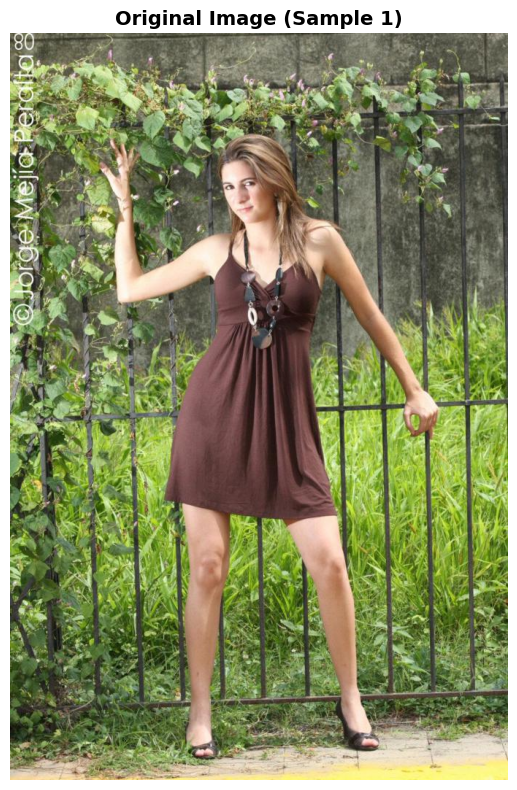

  0%|          | 0/50 [00:00<?, ?it/s]

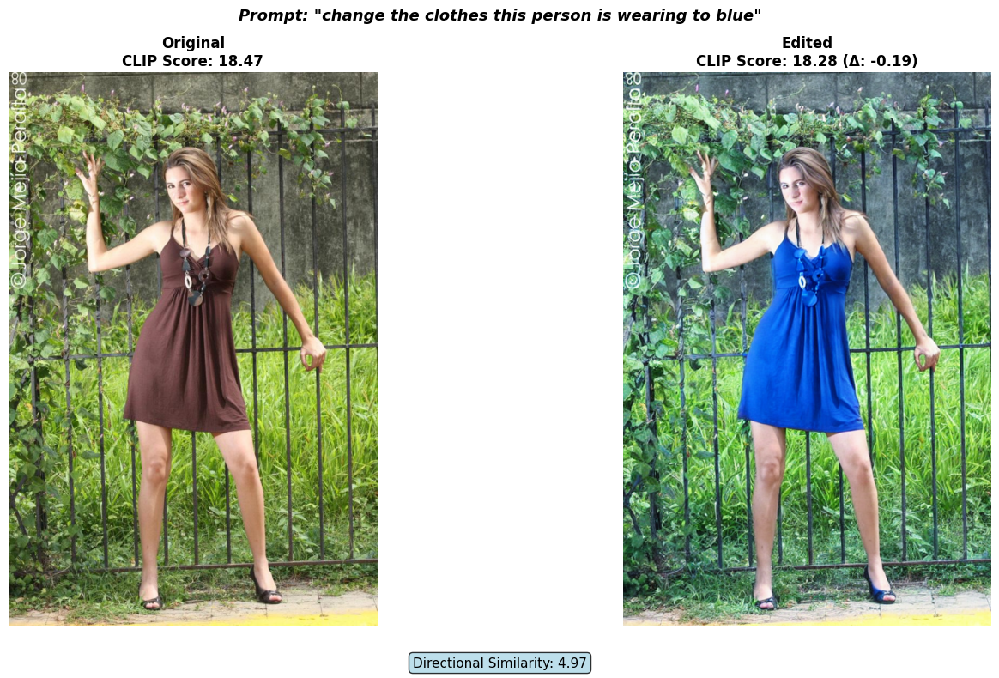

   ✅ CLIP Score: 18.28 | Improvement: -0.19 | Directional Sim: 4.97


  0%|          | 0/50 [00:00<?, ?it/s]

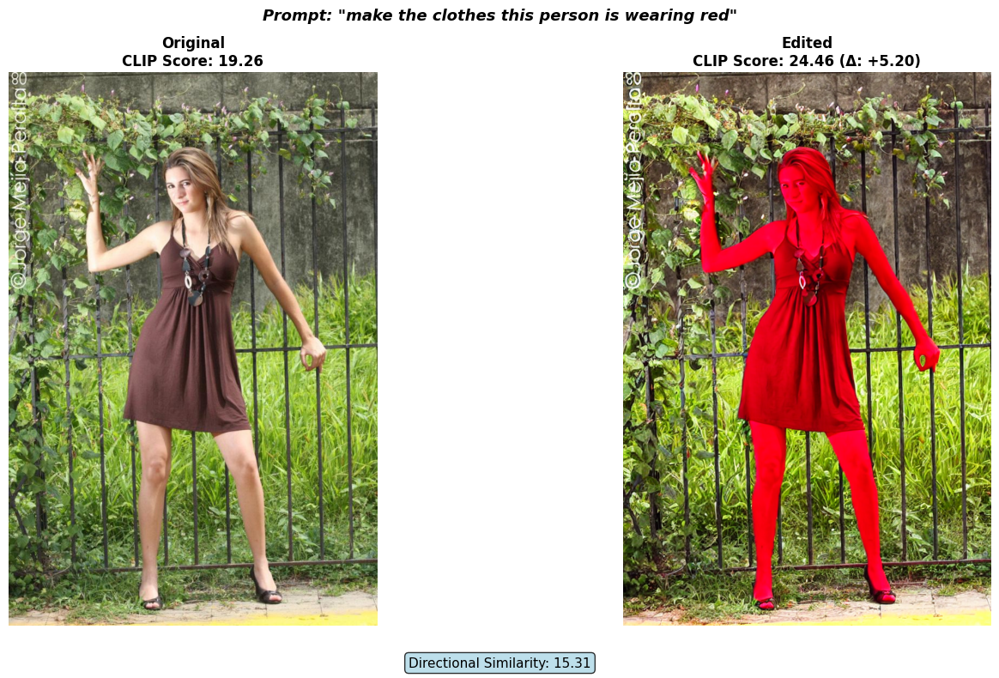

   ✅ CLIP Score: 24.46 | Improvement: +5.20 | Directional Sim: 15.31


  0%|          | 0/50 [00:00<?, ?it/s]

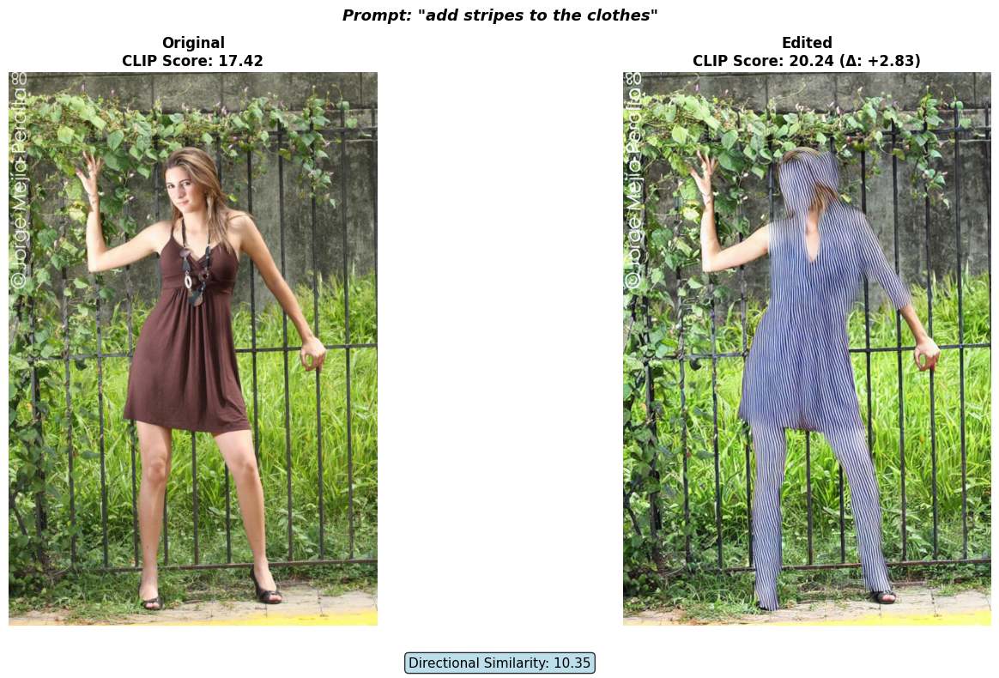

   ✅ CLIP Score: 20.24 | Improvement: +2.83 | Directional Sim: 10.35


  0%|          | 0/50 [00:00<?, ?it/s]

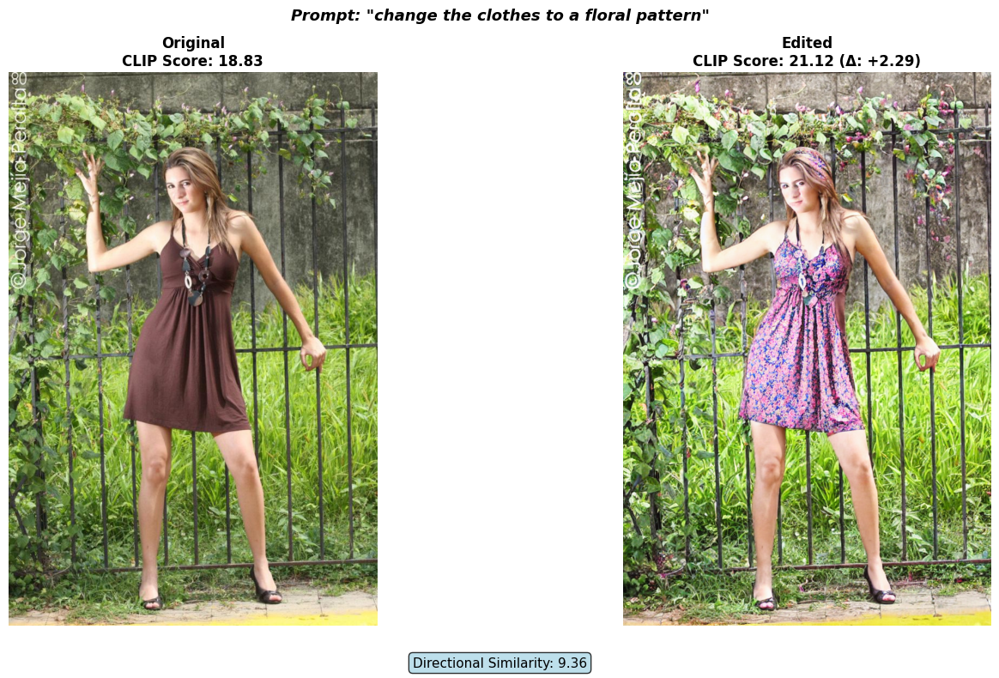

   ✅ CLIP Score: 21.12 | Improvement: +2.29 | Directional Sim: 9.36


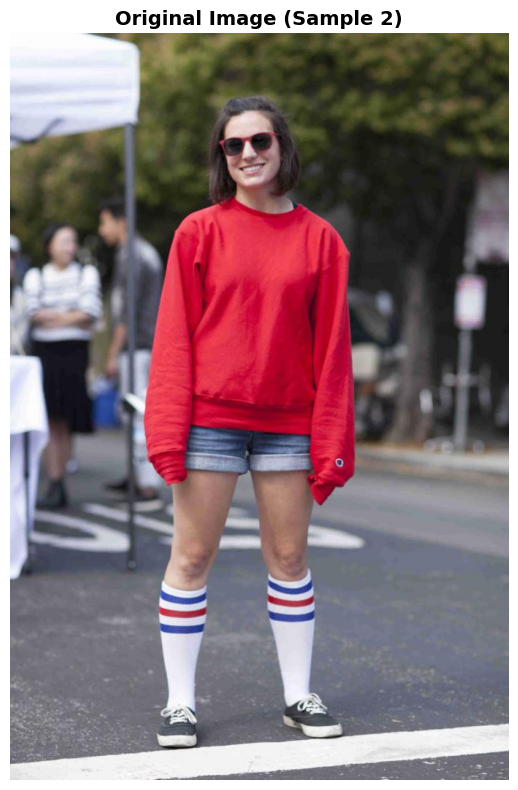

  0%|          | 0/50 [00:00<?, ?it/s]

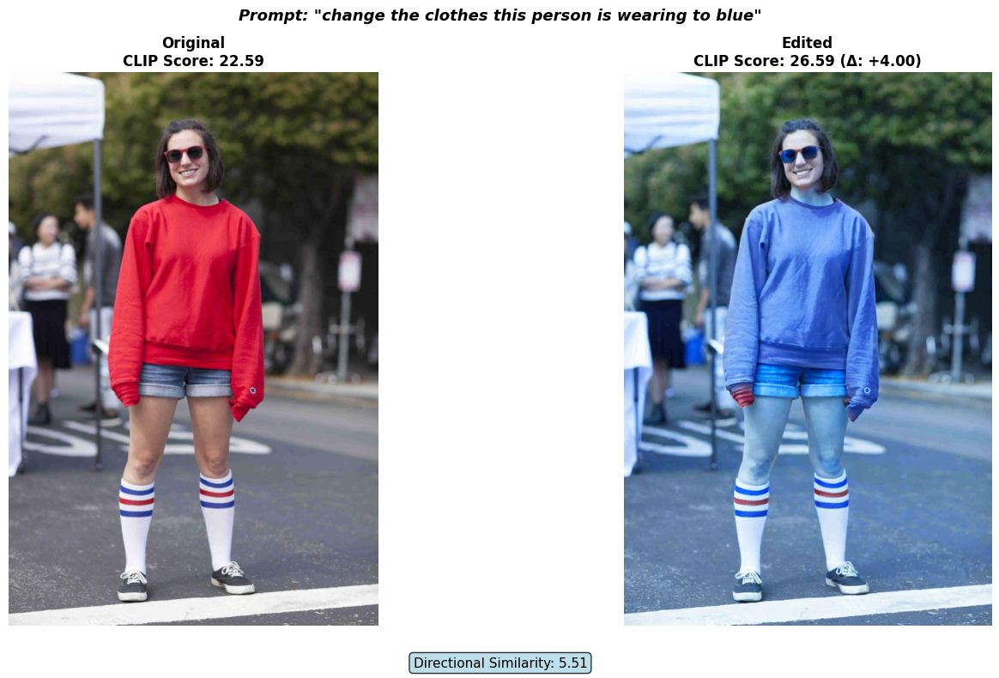

   ✅ CLIP Score: 26.59 | Improvement: +4.00 | Directional Sim: 5.51


  0%|          | 0/50 [00:00<?, ?it/s]

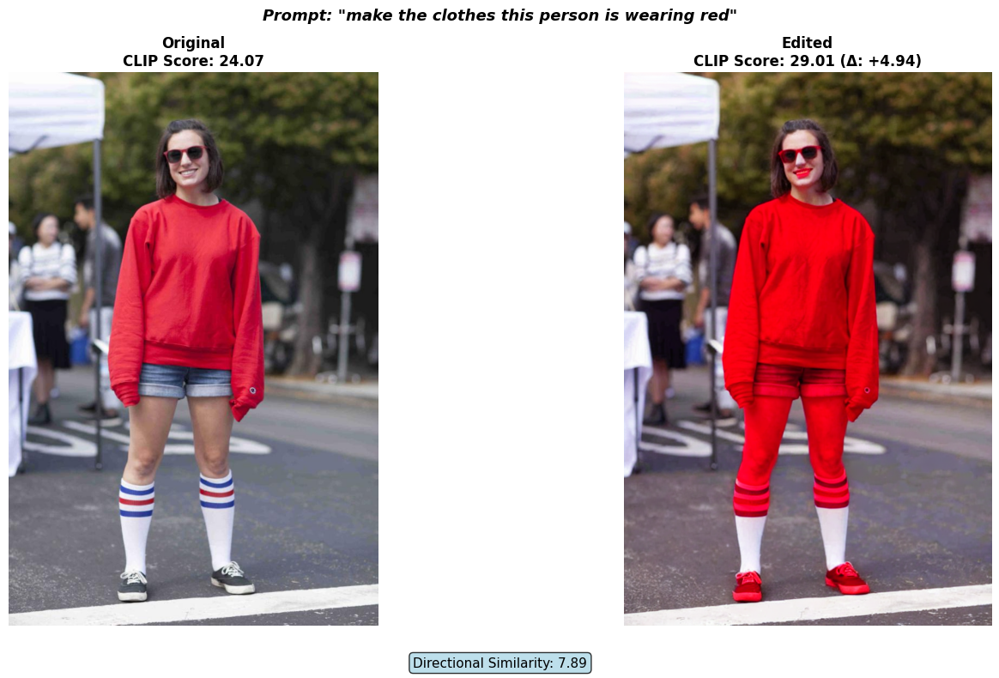

   ✅ CLIP Score: 29.01 | Improvement: +4.94 | Directional Sim: 7.89


  0%|          | 0/50 [00:00<?, ?it/s]

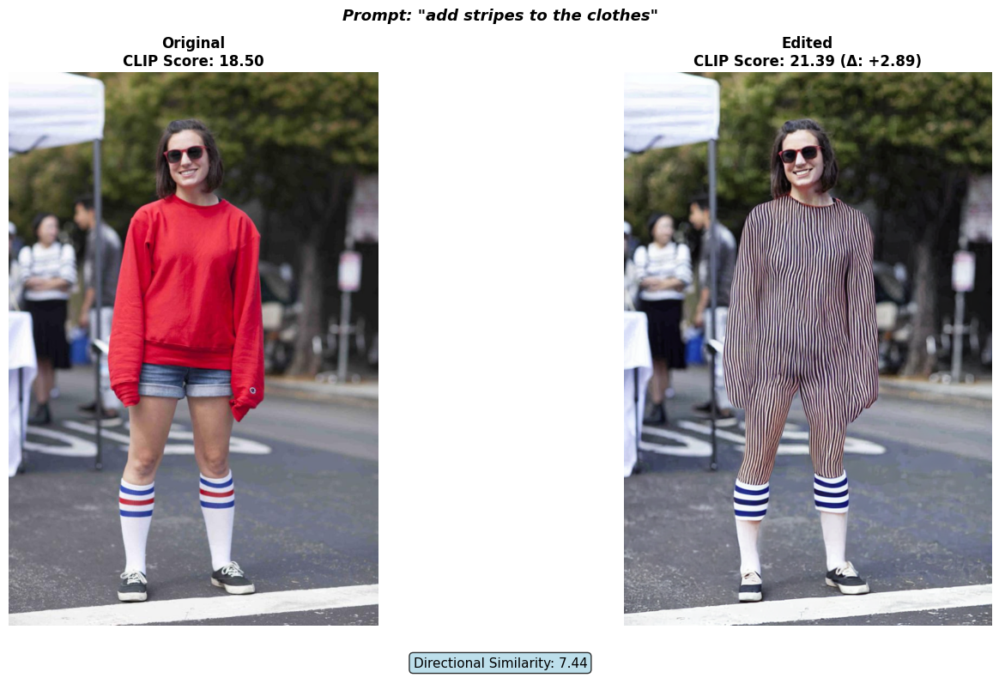

   ✅ CLIP Score: 21.39 | Improvement: +2.89 | Directional Sim: 7.44


  0%|          | 0/50 [00:00<?, ?it/s]

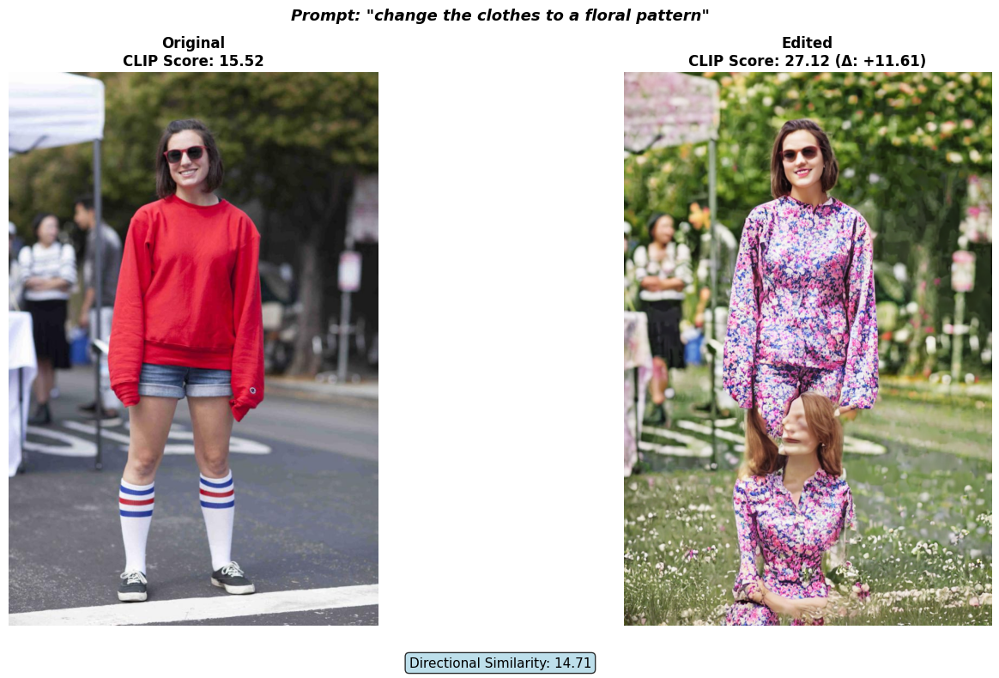

   ✅ CLIP Score: 27.12 | Improvement: +11.61 | Directional Sim: 14.71


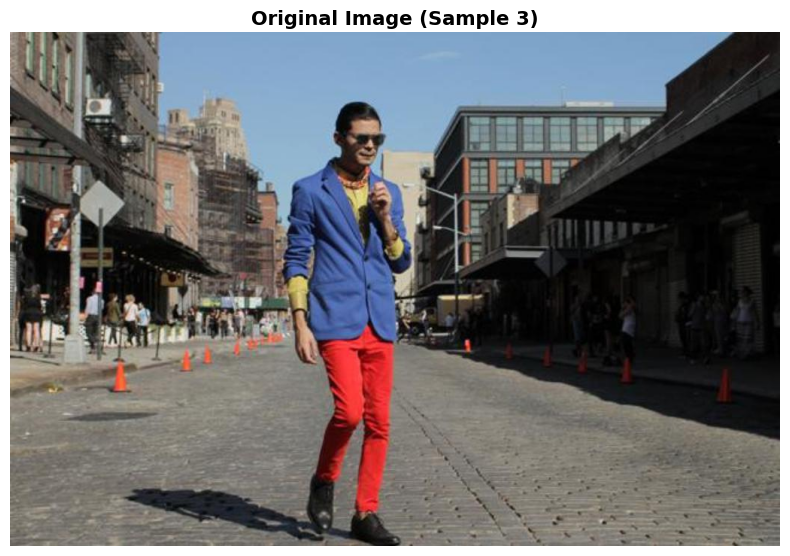

  0%|          | 0/50 [00:00<?, ?it/s]

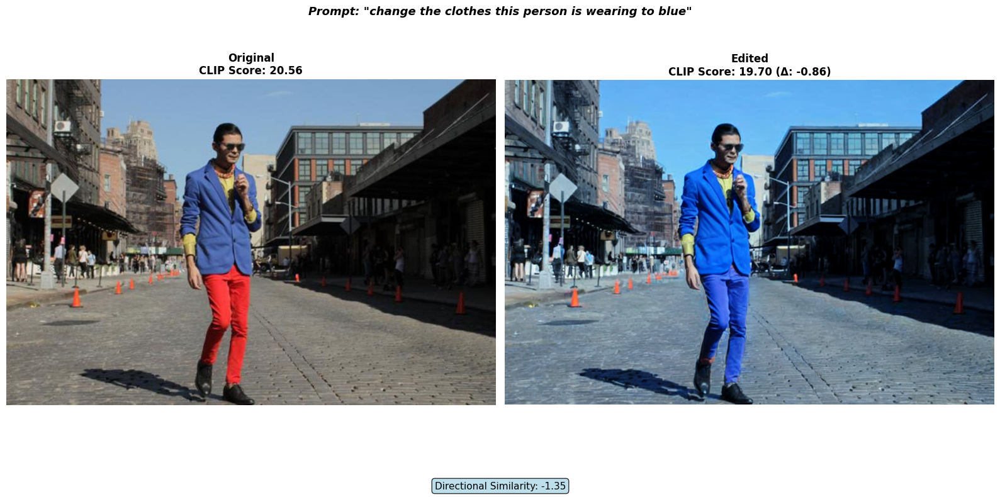

   ✅ CLIP Score: 19.70 | Improvement: -0.86 | Directional Sim: -1.35


  0%|          | 0/50 [00:00<?, ?it/s]

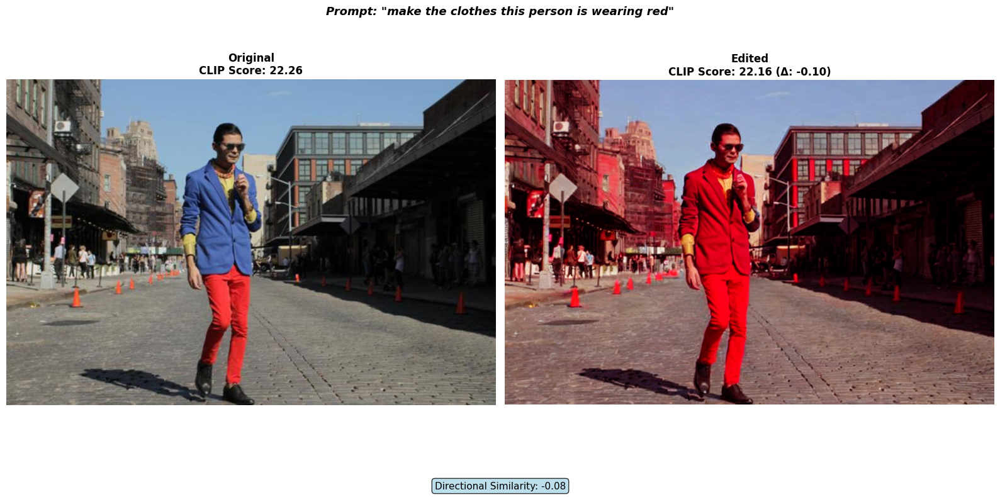

   ✅ CLIP Score: 22.16 | Improvement: -0.10 | Directional Sim: -0.08


  0%|          | 0/50 [00:00<?, ?it/s]

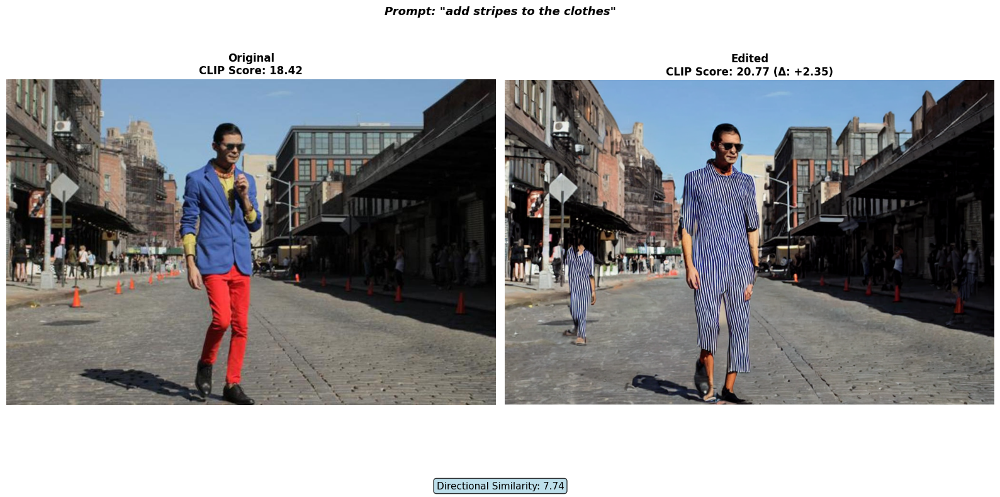

   ✅ CLIP Score: 20.77 | Improvement: +2.35 | Directional Sim: 7.74


  0%|          | 0/50 [00:00<?, ?it/s]

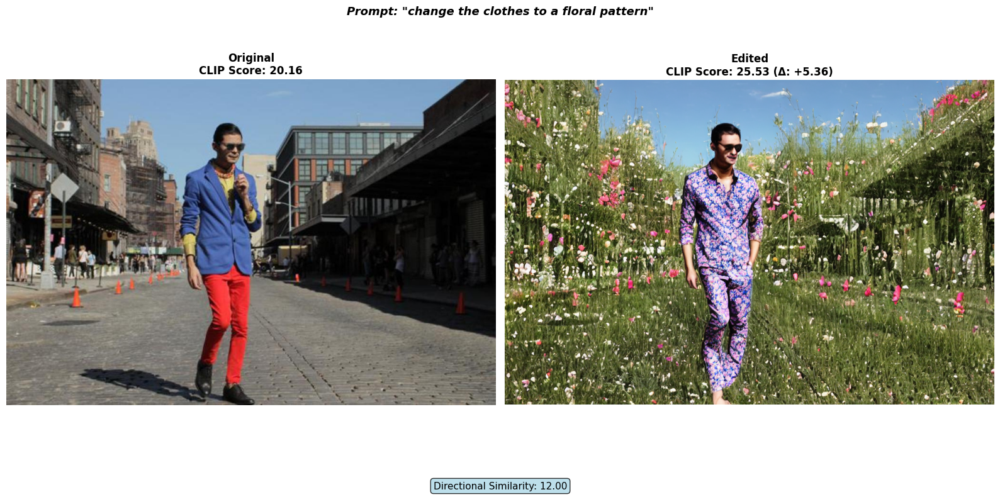

   ✅ CLIP Score: 25.53 | Improvement: +5.36 | Directional Sim: 12.00


In [ ]:
# Evaluating a baseline for InstructPix2Pix on fashionpedia

NUM_SAMPLES = 3  # num of images to test
NUM_INFERENCE_STEPS =50   # inference steps -- means lower = faster, higher = better quality
GUIDANCE_SCALE = 7.5
IMAGE_GUIDANCE_SCALE = 1.5

# this is the output directiory where the eval results are saved.
os.makedirs('evaluation_results', exist_ok=True)
os.makedirs('evaluation_results/images', exist_ok=True)

results = []
all_edits = []

for idx in range(3):
    sample = fashionpedia_samples[idx]
    original_image = sample['image']

    prompts = ['change the clothes this person is wearing to blue',
            'make the clothes this person is wearing red',
            'add stripes to the clothes',
            'change the clothes to a floral pattern']

    if max(original_image.size) > 1024:
      original_image.thumbnail((1024, 1024), Image.Resampling.LANCZOS)

    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    ax.imshow(original_image)
    ax.set_title(f'Original Image (Sample {idx + 1})', fontsize=14, fontweight='bold')
    ax.axis('off')
    plt.tight_layout()
    plt.show()

    for prompt_idx, text_prompt in enumerate(prompts):
      try:
          edited_images = pipe(
              prompt=text_prompt,
              image=original_image,
              num_inference_steps=NUM_INFERENCE_STEPS,
              guidance_scale=GUIDANCE_SCALE,
              image_guidance_scale=IMAGE_GUIDANCE_SCALE,
          ).images
          edited_image = edited_images[0]

          clip_score_original = calculate_clip_score(original_image, text_prompt, clip_model, clip_processor)
          clip_score_edited = calculate_clip_score(edited_image, text_prompt, clip_model, clip_processor)
          clip_directional = calculate_clip_directional_similarity(
              original_image, edited_image, text_prompt, clip_model, clip_processor
          )

          fig, axes = plt.subplots(1, 2, figsize=(16, 8))

          axes[0].imshow(original_image)
          axes[0].set_title(f'Original CLIP Score: {clip_score_original:.2f}',
                            fontsize=12, fontweight='bold')
          axes[0].axis('off')

          axes[1].imshow(edited_image)
          axes[1].set_title(f'Edited LIP Score: {clip_score_edited:.2f} (Δ: {clip_score_edited - clip_score_original:+.2f})',
                            fontsize=12, fontweight='bold')
          axes[1].axis('off')

          metrics_text = f'Value of directional Similarity: {clip_directional:.2f}'
          plt.figtext(0.5, 0.02, metrics_text, ha='center', fontsize=11, bbox=dict(boxstyle='round', facecolor='hotpink', alpha=0.8))

          plt.suptitle(f'Prompt: "{text_prompt}"', fontsize=13, fontweight='bold', style='italic')
          plt.tight_layout()
          plt.subplots_adjust(bottom=0.08)
          plt.show()

          result = {
              'sample_id': f"{idx}_{prompt_idx}",
              'sample_num': idx + 1,
              'edit_num': prompt_idx + 1,
              'prompt': text_prompt,
              'clip_score_original': clip_score_original,
              'clip_score_edited': clip_score_edited,
              'clip_score_improvement': clip_score_edited - clip_score_original,
              'clip_directional_similarity': clip_directional,
          }
          results.append(result)

          all_edits.append({
              'original': original_image,
              'edited': edited_image,
              'prompt': text_prompt,
              'metrics': result
          })

          print(f"   CLIP Score: {clip_score_edited:.2f} | improvement: {clip_score_edited - clip_score_original:+.2f} | directional Sim: {clip_directional:.2f}")

      except Exception as e:
          print(f"   Error: {e}")
          continue

# 4. Fine-Tuning

In [ ]:
gc.collect()
torch.cuda.empty_cache()

pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(
    "timbrooks/instruct-pix2pix",
    torch_dtype=torch.float16,
    safety_checker=None,
)
pipe.to("cuda")

pipe.scheduler = DDPMScheduler.from_config(pipe.scheduler.config)

unet = pipe.unet
vae = pipe.vae
tokenizer = pipe.tokenizer
text_encoder = pipe.text_encoder
noise_scheduler = pipe.scheduler
device = "cuda"

for param in unet.parameters():
    param.requires_grad = False

for name, param in unet.named_parameters():
      should_unfreeze = False

      if "attn2" in name and ("to_k" in name or "to_v" in name or "to_out" in name):
          should_unfreeze = True

      if "attn1" in name and ("to_k" in name or "to_v" in name or "to_q" in name):
          should_unfreeze = True

      if "mid_block" in name:
          should_unfreeze = True

      if "up_blocks.2" in name or "up_blocks.3" in name:
          if "resnets" in name and "conv" in name:
              should_unfreeze = True

      if should_unfreeze:
          param.requires_grad = True

trainable_params = [p for p in unet.parameters() if p.requires_grad]

optimizer = AdamW(trainable_params, lr=1e-5, eps=1e-4, weight_decay=0.01)

print(f"Trainable params: {sum(p.numel() for p in trainable_params):,}")
print(f"Total params: {sum(p.numel() for p in unet.parameters()):,}")
print(f"Trainable %: {100 * sum(p.numel() for p in trainable_params) / sum(p.numel() for p in unet.parameters()):.2f}%")
print("\nUnfrozen layers:")
for name, param in unet.named_parameters():
    if param.requires_grad:
        print(f"  {name}: {param.numel():,}")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Trainable params: 204,885,120
Total params: 859,532,484
Trainable %: 23.84%

Unfrozen layers:
  down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_q.weight: 102,400
  down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_k.weight: 102,400
  down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_v.weight: 102,400
  down_blocks.0.attentions.0.transformer_blocks.0.attn2.to_k.weight: 245,760
  down_blocks.0.attentions.0.transformer_blocks.0.attn2.to_v.weight: 245,760
  down_blocks.0.attentions.0.transformer_blocks.0.attn2.to_out.0.weight: 102,400
  down_blocks.0.attentions.0.transformer_blocks.0.attn2.to_out.0.bias: 320
  down_blocks.0.attentions.1.transformer_blocks.0.attn1.to_q.weight: 102,400
  down_blocks.0.attentions.1.transformer_blocks.0.attn1.to_k.weight: 102,400
  down_blocks.0.attentions.1.transformer_blocks.0.attn1.to_v.weight: 102,400
  down_blocks.0.attentions.1.transformer_blocks.0.attn2.to_k.weight: 245,760
  down_blocks.0.attentions.1.transformer_blocks.0.attn2.t

# 4.1 Training Loops (Edited to include Bounding boxes and zoning from Fashionpedia)

In [ ]:
from torch.optim.lr_scheduler import CosineAnnealingLR
from torchvision.transforms.functional import to_pil_image

def encode_prompt(texts):
    tokens = tokenizer(
        list(texts),
        padding="max_length",
        max_length=tokenizer.model_max_length,
        truncation=True,
        return_tensors="pt",
    ).input_ids.to(device)
    with torch.no_grad():
        text_embeds = text_encoder(tokens)[0]
    return text_embeds

def encode_vae_images(images):
    images = images.to(device, dtype=torch.float16)
    with torch.no_grad():
        latents = vae.encode(images).latent_dist.sample()
    return latents * vae.config.scaling_factor

def create_bbox_mask(bboxes, image_size, expansion_factor=1.15):
    """
    Author: Disclaimer! I Used ChatGPT to help me generate this function. The
    source idea and inspiration came from Bayesian Approach to Digital Matting
    (Chuang Et. al 2001)

    Create soft masks from bounding boxes with slight expansion for context.

    Args:
        bboxes: List of [x1, y1, x2, y2] bounding boxes (normalized 0-1 or pixel coords)
        image_size: (height, width) of the image
        expansion_factor: Factor to expand bbox (1.15 = 15% larger)
    """
    h, w = image_size
    batch_size = len(bboxes)
    masks = torch.zeros(batch_size, 1, h, w, device=device, dtype=torch.float16)

    for i, bbox in enumerate(bboxes):
        if bbox is None or len(bbox) != 4:
            continue

        x1, y1, x2, y2 = bbox
        # If normalized coordinates, convert to pixels
        if x2 <= 1.0:
            x1, x2 = x1 * w, x2 * w
            y1, y2 = y1 * h, y2 * h
        # Expand bbox slightly
        cx, cy = (x1 + x2) / 2, (y1 + y2) / 2
        bw, bh = (x2 - x1) * expansion_factor, (y2 - y1) * expansion_factor
        x1_new = max(0, int(cx - bw/2))
        y1_new = max(0, int(cy - bh/2))
        x2_new = min(w, int(cx + bw/2))
        y2_new = min(h, int(cy + bh/2))
        masks[i, 0, y1_new:y2_new, x1_new:x2_new] = 1.0

    return masks

def compute_hierarchical_loss(noise_pred, noise, mask_latent, bbox_latent,
                               lambda_context=0.3, lambda_preserve=0.5):
    """
    Author: Disclaimer! I Used ChatGPT to help me generate this function. The
    source idea and inspiration came from Bayesian Approach to Digital Matting
    (Chuang Et. al 2001)

    Three-zone hierarchical loss:
    - Tight clothing region (from segmentation): full editing loss
    - Context region: moderate preservation (allows smooth transitions)
    - Background: strong preservation
    """
    # Zone 1: Tight clothing mask (primary edit region)
    M_tight = mask_latent

    # Zone 2: Transition Zone
    M_context = bbox_latent * (1.0 - mask_latent)

    # Zone 3: Background
    M_bg = 1.0 - bbox_latent

    # Compute losses for each zone
    L_tight = F.mse_loss((noise_pred * M_tight).float(), (noise * M_tight).float())
    L_context = F.mse_loss((noise_pred * M_context).float(), (noise * M_context).float())
    L_bg = F.mse_loss((noise_pred * M_bg).float(), (noise * M_bg).float())

    # Weighted combination
    total_loss = L_tight + lambda_context * L_context + lambda_preserve * L_bg

    return total_loss, {
        'L_tight': L_tight.item(),
        'L_context': L_context.item(),
        'L_bg': L_bg.item()
    }

@torch.no_grad()
def validate(val_loader, num_samples=50):
  """Calculate validation metrics.
      Disclaimer: I used ChatGPT to help me generate part of this function
  """
  unet.eval()

  val_losses = []
  clip_scores = []
  dir_sims = []

  samples_processed = 0
  for batch in val_loader:
      if samples_processed >= num_samples: #no samples
          break
      pixel_values = batch["pixel_values"].to(device, dtype=torch.float16)
      cond_images = batch["conditioning_image"].to(device, dtype=torch.float16)
      masks = batch["mask"].to(device, dtype=torch.float16)
      prompts = batch["prompt"]
      bboxes = batch.get("bbox", None)

      # Compute validation loss
      target_latents = encode_vae_images(pixel_values)
      cond_latents = encode_vae_images(cond_images)
      mask_latent = F.interpolate(masks, size=target_latents.shape[-2:], mode="nearest")
      mask_latent = mask_latent.expand(-1, 4, -1, -1)

      # Create bounding boxes if available
      if bboxes is not None:
          bbox_masks = create_bbox_mask(bboxes, (masks.shape[2], masks.shape[3]))
          bbox_latent = F.interpolate(bbox_masks, size=target_latents.shape[-2:], mode="nearest")
          bbox_latent = bbox_latent.expand(-1, 4, -1, -1)
      else:
          # I used CHATGPT to help me design this fallback
          bbox_latent = F.max_pool2d(mask_latent, kernel_size=5, stride=1, padding=2)

      noise = torch.randn_like(target_latents)
      timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps,
                                  (target_latents.shape[0],), device=device, dtype=torch.long)
      noisy_latents = noise_scheduler.add_noise(target_latents, noise, timesteps)
      model_input = torch.cat([noisy_latents, cond_latents], dim=1)
      text_embeds = encode_prompt(prompts)

      with torch.autocast(device_type="cuda", dtype=torch.float16):

      #calculate the loss
      noise_pred = unet(model_input, timesteps, encoder_hidden_states=text_embeds, return_dict=False)[0]
      loss, _ = compute_hierarchical_loss(noise_pred, noise, mask_latent, bbox_latent,
                                          lambda_context=LAMBDA_CONTEXT,
                                          lambda_preserve=LAMBDA_PRESERVE)
      val_losses.append(loss.item())
      if samples_processed % 5 == 0: #skip every 5 to save compute time
          cond_img_pil = to_pil_image(cond_images[0].cpu().float() * 0.5 + 0.5)

          with torch.autocast("cuda"):
              edited = pipe(
                  prompt=prompts[0],
                  image=cond_img_pil,
                  num_inference_steps=20,
                  guidance_scale=7.5,
                  image_guidance_scale=1.5,
              ).images[0]

          clip_score = calculate_clip_score(edited, prompts[0], clip_model, clip_processor)
          dir_sim = calculate_clip_directional_similarity(cond_img_pil, edited, prompts[0], clip_model, clip_processor)

          clip_scores.append(clip_score)
          dir_sims.append(dir_sim)

      samples_processed += 1

  unet.train()

  return {
      "val_loss": sum(val_losses) / len(val_losses),
      "clip_score": sum(clip_scores) / len(clip_scores) if clip_scores else 0,
      "dir_sim": sum(dir_sims) / len(dir_sims) if dir_sims else 0,
  }


# Hyperparameters
EPOCHS = 4
MAX_GRAD_NORM = 1.0
LAMBDA_CONTEXT = 0.5  # Weight for context region
LAMBDA_PRESERVE = 0.7  # Weight for background preservation
PATIENCE = 2

num_training_steps = EPOCHS * len(train_loader)
scheduler = CosineAnnealingLR(optimizer, T_max=num_training_steps)

unet.train()
train_losses = []
val_metrics_history = []
best_val_dirsim = float("-inf")
epochs_no_improve = 0

for epoch in range(EPOCHS):
  epoch_losses = []
  loss_components = {'tight': [], 'context': [], 'bg': []}
  pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS}")

  for step, batch in enumerate(pbar):
      pixel_values = batch["pixel_values"].to(device, dtype=torch.float16)
      cond_images = batch["conditioning_image"].to(device, dtype=torch.float16)
      masks = batch["mask"].to(device, dtype=torch.float16)
      prompts = batch["prompt"]

      bboxes = batch.get("bbox", None)

      with torch.no_grad():
          target_latents = encode_vae_images(pixel_values)
          cond_latents = encode_vae_images(cond_images)
          mask_latent = F.interpolate(masks, size=target_latents.shape[-2:], mode="nearest")
          mask_latent = mask_latent.expand(-1, 4, -1, -1)
          if bboxes is not None:
              bbox_masks = create_bbox_mask(bboxes, (masks.shape[2], masks.shape[3]))
              bbox_latent = F.interpolate(bbox_masks, size=target_latents.shape[-2:], mode="nearest")
              bbox_latent = bbox_latent.expand(-1, 4, -1, -1)
          else:
              # Fallback: use dilated segmentation mask as approximation from chatGPT
              bbox_latent = F.max_pool2d(mask_latent, kernel_size=5, stride=1, padding=2)

      noise = torch.randn_like(target_latents)
      bsz = target_latents.shape[0]
      timesteps = torch.randint(
          0, noise_scheduler.config.num_train_timesteps,
          (bsz,), device=device, dtype=torch.long
      )

      noisy_latents = noise_scheduler.add_noise(target_latents, noise, timesteps)
      model_input = torch.cat([noisy_latents, cond_latents], dim=1)
      text_embeds = encode_prompt(prompts)

      optimizer.zero_grad()
      with torch.autocast(device_type="cuda", dtype=torch.float16):
          noise_pred = unet(
              model_input,
              timesteps,
              encoder_hidden_states=text_embeds,
              return_dict=False
          )[0]
      loss, loss_dict = compute_hierarchical_loss(
          noise_pred, noise, mask_latent, bbox_latent,
          lambda_context=LAMBDA_CONTEXT,
          lambda_preserve=LAMBDA_PRESERVE
      )


      loss_components['tight'].append(loss_dict['L_tight'])
      loss_components['context'].append(loss_dict['L_context'])
      loss_components['bg'].append(loss_dict['L_bg'])
      if not torch.isfinite(loss):
          print(f"Non-finite loss at step {step}, skipping...")
          continue

      loss.backward()
      torch.nn.utils.clip_grad_norm_(trainable_params, MAX_GRAD_NORM)

      # Check for NaN gradients
      has_nan_grad = False
      for p in trainable_params:
          if p.grad is not None and not torch.isfinite(p.grad).all():
              has_nan_grad = True
              break

      if has_nan_grad:
          print(f"Non-finite gradient at step {step}, skipping...")
          optimizer.zero_grad()
          continue

      optimizer.step()
      scheduler.step()

      epoch_losses.append(loss.item())
      pbar.set_postfix({
          "loss": f"{loss.item():.4f}",
          "L_tight": f"{loss_dict['L_tight']:.3f}",
          "L_ctx": f"{loss_dict['L_context']:.3f}",
          "lr": f"{scheduler.get_last_lr()[0]:.2e}"
      })

  avg_loss = sum(epoch_losses) / len(epoch_losses) if epoch_losses else float('nan')
  train_losses.append(avg_loss)

  # ChatGPT generated these print statements for me
  print(f"Epoch {epoch+1} average loss: {avg_loss:.4f}")
  print(f"  Loss breakdown - Tight: {sum(loss_components['tight'])/len(loss_components['tight']):.4f}, "
        f"Context: {sum(loss_components['context'])/len(loss_components['context']):.4f}, "
        f"Background: {sum(loss_components['bg'])/len(loss_components['bg']):.4f}")

  print(f"Running validation...")
  val_metrics = validate(val_loader, num_samples=50)
  val_metrics_history.append(val_metrics)

  print(f"  Val Loss: {val_metrics['val_loss']:.4f}")
  print(f"  CLIP Score: {val_metrics['clip_score']:.2f}")
  print(f"  Directional Sim: {val_metrics['dir_sim']:.2f}")


#Early stopping if no improvement
  if val_metrics['dir_sim'] > best_val_dirsim:
      best_val_dirsim = val_metrics['dir_sim']
      epochs_no_improve = 0
      torch.save(unet.state_dict(), "unet_best.pt")
      print(f"  New best model saved! (dir_sim: {best_val_dirsim:.2f})")
  else:
      epochs_no_improve += 1
      print(f"  No improvement for {epochs_no_improve} epoch(s)")

      if epochs_no_improve >= PATIENCE:
          print(f"Early stopping triggered at epoch {epoch+1}")
          break

#save at this checkpoint
  torch.save({
      'epoch': epoch,
      'unet_state_dict': unet.state_dict(),
      'optimizer_state_dict': optimizer.state_dict(),
      'scheduler_state_dict': scheduler.state_dict(),
      'train_losses': train_losses,
      'val_metrics': val_metrics_history,
  }, f"checkpoint_epoch{epoch+1}.pt")

print("Training complete!")
print(f"Best directional similarity: {best_val_dirsim:.2f}")

Epoch 1/4: 100%|██████████| 6400/6400 [59:30<00:00,  1.79it/s, loss=0.0257, L_tight=0.011, L_ctx=0.007, lr=8.54e-06]


Epoch 1 average loss: 0.0486
  Loss breakdown - Tight: 0.0260, Context: 0.0084, Background: 0.0264
Running validation...


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  Val Loss: 0.0474
  CLIP Score: 24.77
  Directional Sim: 7.72
  New best model saved! (dir_sim: 7.72)


Epoch 2/4: 100%|██████████| 6400/6400 [59:28<00:00,  1.79it/s, loss=0.1189, L_tight=0.096, L_ctx=0.017, lr=5.00e-06]


Epoch 2 average loss: 0.0494
  Loss breakdown - Tight: 0.0268, Context: 0.0085, Background: 0.0263
Running validation...


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  Val Loss: 0.0536
  CLIP Score: 24.72
  Directional Sim: 6.90
  No improvement for 1 epoch(s)


Epoch 3/4: 100%|██████████| 6400/6400 [59:26<00:00,  1.79it/s, loss=0.0312, L_tight=0.020, L_ctx=0.004, lr=1.46e-06]


Epoch 3 average loss: 0.0501
  Loss breakdown - Tight: 0.0267, Context: 0.0086, Background: 0.0272
Running validation...


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  Val Loss: 0.0590
  CLIP Score: 24.95
  Directional Sim: 8.12
  New best model saved! (dir_sim: 8.12)


Epoch 4/4: 100%|██████████| 6400/6400 [59:22<00:00,  1.80it/s, loss=0.1184, L_tight=0.080, L_ctx=0.020, lr=0.00e+00]


Epoch 4 average loss: 0.0489
  Loss breakdown - Tight: 0.0265, Context: 0.0084, Background: 0.0260
Running validation...


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  Val Loss: 0.0461
  CLIP Score: 23.72
  Directional Sim: 6.44
  No improvement for 1 epoch(s)
Training complete!
Best directional similarity: 8.12


In [ ]:
# plot training loss

plt.figure(figsize=(10, 5))
plt.plot(range(1, len(train_losses) + 1), train_losses, marker='o')
plt.xlabel("Epoch")
plt.ylabel("Average Loss")
plt.title("Training Loss - Bounding Box Fine-tuning")
plt.grid(True)
plt.show()

NameError: name 'plt' is not defined

In [ ]:
# Load fine-tuned model for eval

state_dict = torch.load("unet_best.pt", map_location=device)
unet.load_state_dict(state_dict, strict=False)

pipe.unet = unet
pipe.to("cuda")
pipe.unet.eval()

print("Fine-tuned model loaded!")

Fine-tuned model loaded!


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

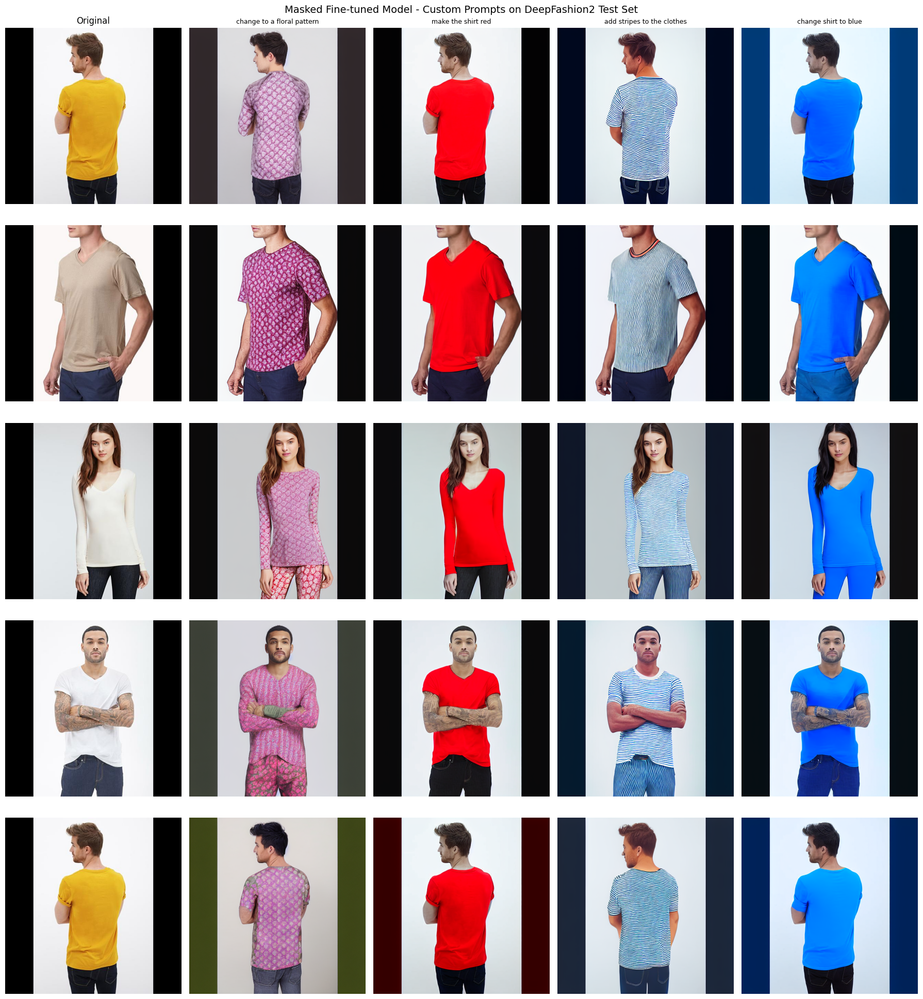


=== Custom Prompts Evaluation ===
Mean CLIP Score: 22.14
Mean Directional Similarity: 11.91

Per-prompt averages:
                            clip_score  directional_similarity
prompt                                                        
add stripes to the clothes   22.486993                9.176104
change shirt to blue         21.110638                7.878756
change to a floral pattern   21.252272               13.666346
make the shirt red           23.720772               16.923051


In [ ]:
custom_prompts = [
    "change to a floral pattern",
    "make the shirt red",
    "add stripes to the clothes",
    "change shirt to blue",
]

NUM_TEST_IMAGES = 5

fig, axes = plt.subplots(NUM_TEST_IMAGES, len(custom_prompts) + 1, figsize=(18, 4 * NUM_TEST_IMAGES))

custom_results = []

for row in range(NUM_TEST_IMAGES):
    actual_idx = test_ds.indices[row]
    t = triplets[actual_idx]
    src = dataset["train"][t["src_idx"]]
    original_image = src["images"]

    if max(original_image.size) > 512:
        original_image = original_image.copy()
        original_image.thumbnail((512, 512), Image.Resampling.LANCZOS)

    axes[row, 0].imshow(original_image)
    axes[row, 0].set_title("Original" if row == 0 else "")
    axes[row, 0].axis("off")

    for col, prompt in enumerate(custom_prompts):
        with torch.autocast("cuda"):
            edited = pipe(
                prompt=prompt,
                image=original_image,
                num_inference_steps=50,
                guidance_scale=7.5,
                image_guidance_scale=1.5,
            ).images[0]

        clip_score = calculate_clip_score(edited, prompt, clip_model, clip_processor)
        clip_directional = calculate_clip_directional_similarity(
            original_image, edited, prompt, clip_model, clip_processor
        )
        lpips_val = calculate_lpips(original_image, edited)

        custom_results.append({
            'image': row,
            'prompt': prompt,
            'clip_score': clip_score,
            'directional_similarity': clip_directional,
            'lpips': lpips_val,
        })

        axes[row, col + 1].imshow(edited)
        axes[row, col + 1].set_title(prompt if row == 0 else "", fontsize=9)
        axes[row, col + 1].axis("off")

plt.tight_layout()
plt.savefig("custom_prompts_deepfashion2.png", dpi=150, bbox_inches='tight')
plt.show()

# Summary
df_custom = pd.DataFrame(custom_results)
print("\n Custom Prompts Evaluation ===")
print(f"mean CLIP Score: {df_custom['clip_score'].mean():.2f}")
print(f"mean Directional Similarity: {df_custom['directional_similarity'].mean():.2f}")
print(f"mean LPIPS: {df_custom['lpips'].mean():.4f}")
print("\nPer-prompt averages:")
print(df_custom.groupby('prompt')[['clip_score', 'directional_similarity']].mean())

In [ ]:
# compare baseline vs fine tuned
print(f"Baseline Mean CLIP Score: {pd.DataFrame(results)['clip_score_edited'].mean():.2f}")
print(f"Fine-tuned Mean CLIP Score: {df_custom['clip_score'].mean():.2f}")
print(f"\nBaseline Mean Directional Sim: {pd.DataFrame(results)['clip_directional_similarity'].mean():.2f}")
print(f"Fine-tuned Mean Directional Sim: {df_custom['directional_similarity'].mean():.2f}")

=== Comparison ===
Baseline Mean CLIP Score: 23.03
Fine-tuned Mean CLIP Score: 22.14

Baseline Mean Directional Sim: 7.82
Fine-tuned Mean Directional Sim: 11.91


In [ ]:
# evaluating on fashion pedia dataset

test_prompts = [
    "change to a floral pattern",
    "make the shirt red",
    "add stripes to the clothes",
    "change shirt to blue",
]

NUM_SAMPLES = 5

finetuned_fashionpedia_results = []

for idx in range(NUM_SAMPLES):
    sample = fashionpedia_samples[idx]
    original_image = sample['image']

    if max(original_image.size) > 512:
        original_image = original_image.copy()
        original_image.thumbnail((512, 512), Image.Resampling.LANCZOS)

    for prompt in test_prompts:
        # Generate with fine-tuned model
        with torch.autocast("cuda"):
            edited = pipe(
                prompt=prompt,
                image=original_image,
                num_inference_steps=50,
                guidance_scale=7.5,
                image_guidance_scale=1.5,
            ).images[0]

        # Calculate metrics
        clip_score = calculate_clip_score(edited, prompt, clip_model, clip_processor)
        clip_directional = calculate_clip_directional_similarity(
            original_image, edited, prompt, clip_model, clip_processor
        )

        finetuned_fashionpedia_results.append({
            'sample': idx,
            'prompt': prompt,
            'clip_score': clip_score,
            'directional_similarity': clip_directional,
        })

df_finetuned_fp = pd.DataFrame(finetuned_fashionpedia_results)

print(f"Mean CLIP Score: {df_finetuned_fp['clip_score'].mean():.2f}")
print(f"Mean Directional Similarity: {df_finetuned_fp['directional_similarity'].mean():.2f}")

# Compare with baseline on FashionPedia
print(f"Baseline Mean CLIP Score: {pd.DataFrame(results)['clip_score_edited'].mean():.2f}")
print(f"Fine-tuned Mean CLIP Score: {df_finetuned_fp['clip_score'].mean():.2f}")
print(f"\nBaseline Mean Directional Sim: {pd.DataFrame(results)['clip_directional_similarity'].mean():.2f}")
print(f"Fine-tuned Mean Directional Sim: {df_finetuned_fp['directional_similarity'].mean():.2f}")

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

=== Fine-tuned Model on FashionPedia ===
Mean CLIP Score: 19.16
Mean Directional Similarity: 10.61

=== Comparison on FashionPedia ===
Baseline Mean CLIP Score: 23.03
Fine-tuned Mean CLIP Score: 19.16

Baseline Mean Directional Sim: 7.82
Fine-tuned Mean Directional Sim: 10.61


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

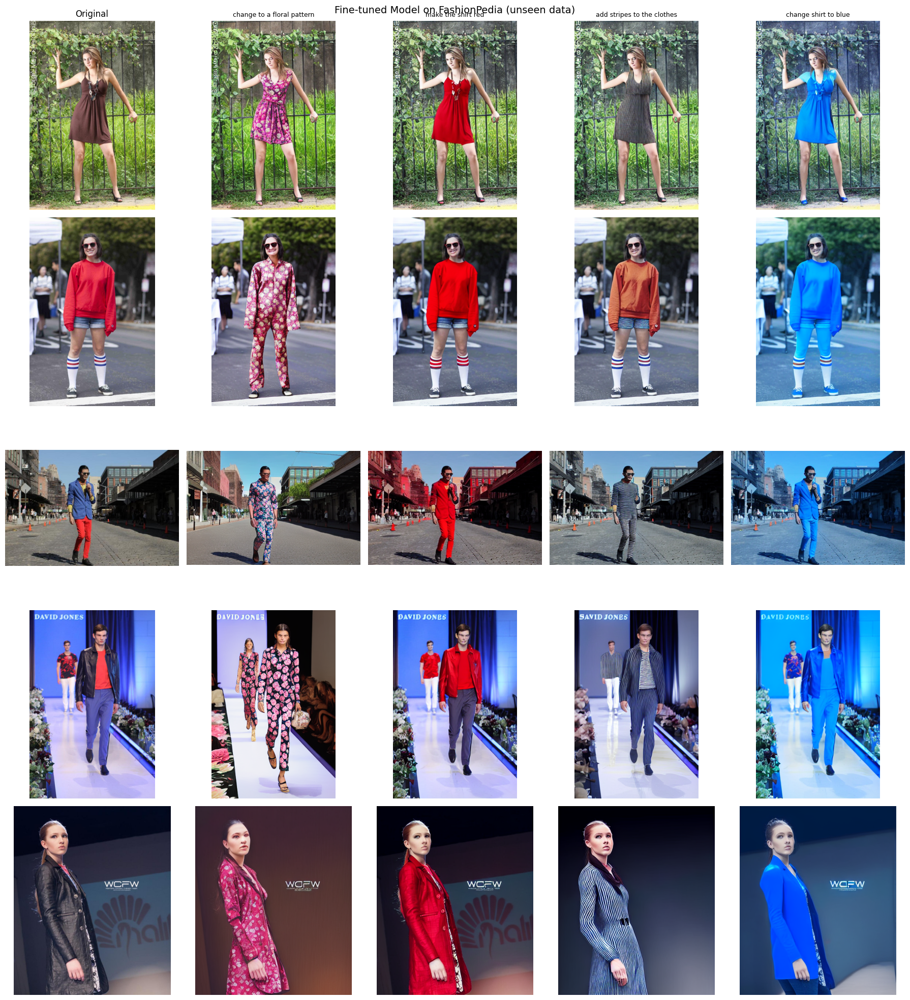

In [ ]:
# plotting for fine tuned model on fashionpedia

fig, axes = plt.subplots(NUM_SAMPLES, len(test_prompts) + 1, figsize=(18, 4 * NUM_SAMPLES))

for row in range(NUM_SAMPLES):
    sample = fashionpedia_samples[row]
    original_image = sample['image']

    if max(original_image.size) > 512:
        original_image = original_image.copy()
        original_image.thumbnail((512, 512), Image.Resampling.LANCZOS)

    axes[row, 0].imshow(original_image)
    axes[row, 0].set_title("Original" if row == 0 else "")
    axes[row, 0].axis("off")

    for col, prompt in enumerate(test_prompts):
        with torch.autocast("cuda"):
            edited = pipe(
                prompt=prompt,
                image=original_image,
                num_inference_steps=50,
                guidance_scale=7.5,
                image_guidance_scale=1.5,
            ).images[0]

        axes[row, col + 1].imshow(edited)
        axes[row, col + 1].set_title(prompt if row == 0 else "", fontsize=9)
        axes[row, col + 1].axis("off")

plt.suptitle("Fine-tuned Model on FashionPedia (unseen data)", fontsize=14)
plt.tight_layout()
plt.savefig("finetuned_on_fashionpedia.png", dpi=150, bbox_inches='tight')
plt.show()

# 5. The following code is used to generate some visualizations for our paper given the datasets we were using (FashionPedia). It is mostly generated using AI and not use in our actual experimentation.

Loading FashionPedia stream...
Fetching samples...
Visualizing Sample 0...


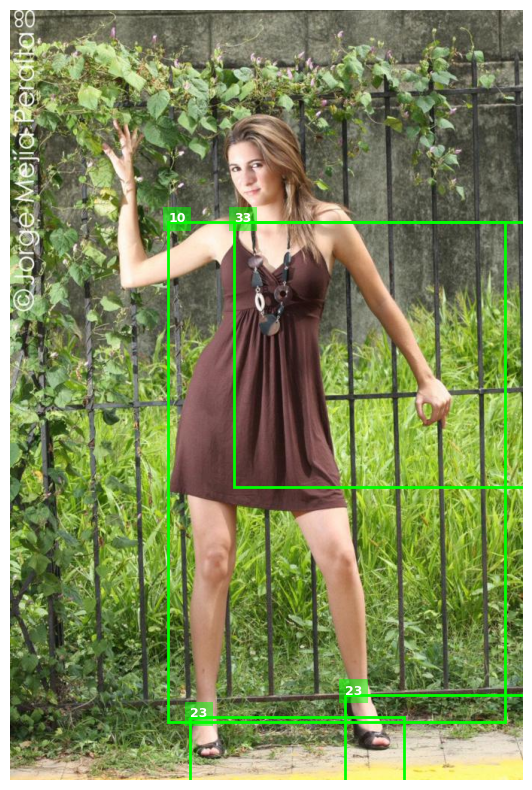

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from datasets import load_dataset

# 1. Load dataset
print("Loading FashionPedia stream...")
dataset_fashionpedia = load_dataset("detection-datasets/fashionpedia", split="train", streaming=True)

# 2. Grab just 5 samples
print("Fetching samples...")
fashionpedia_samples = list(dataset_fashionpedia.take(5))

# 3. Robust Helper to get Class Names
# We check if 'objects' is a dict or an object to avoid the AttributeError
def get_category_names(dataset):
    try:
        # Try standard Hugging Face object access
        return dataset.features['objects'].feature['category'].names
    except AttributeError:
        try:
            # Fallback: Try dictionary access (common in some Colab envs)
            return dataset.features['objects']['feature']['category']['names']
        except (KeyError, TypeError):
            # If all else fails, return None and we will just print IDs
            print("Warning: Could not extract class names. Displaying IDs only.")
            return None

class_names = get_category_names(dataset_fashionpedia)

def get_label_name(cat_id):
    if class_names and cat_id < len(class_names):
        return class_names[cat_id]
    return str(cat_id) # Return ID if names failed to load

# 4. Visualization Function
def visualize_sample(sample):
    image = sample['image']
    objects = sample['objects']

    # Create a figure
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(image)

    # Loop through all objects detected in the image
    # Note: Some datasets use 'categories' instead of 'category', we handle both
    cat_keys = objects.get('category', objects.get('categories', []))

    for bbox, cat_id in zip(objects['bbox'], cat_keys):
        # Format is [x_min, y_min, width, height]
        x, y, w, h = bbox

        # Create a Rectangle patch
        rect = patches.Rectangle((x, y), w, h, linewidth=2, edgecolor='#00FF00', facecolor='none')
        ax.add_patch(rect)

        # Add the label text above the box
        label_text = get_label_name(cat_id)
        ax.text(x, y, label_text, color='white', fontsize=9, weight='bold',
                bbox=dict(facecolor='#00FF00', edgecolor='none', alpha=0.5))

    plt.axis('off')
    plt.show()

# 5. Show the first image
print(f"Visualizing Sample 0...")
visualize_sample(fashionpedia_samples[0])

Loading FashionPedia stream...


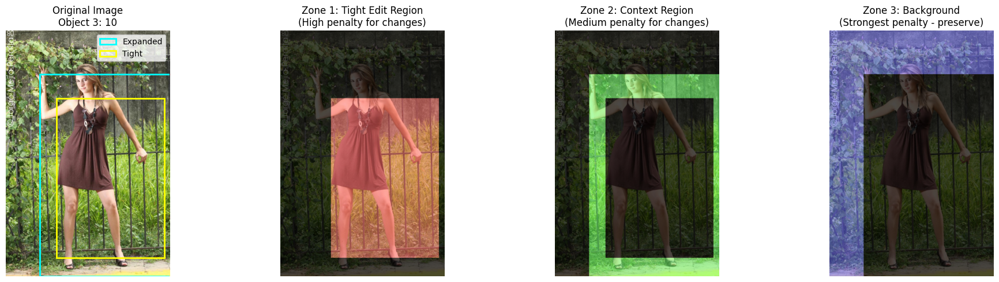


Zone Statistics:
Zone 1 (Tight): 297920 pixels (42.7%)
Zone 2 (Context): 156760 pixels (22.4%)
Zone 3 (Background): 243688 pixels (34.9%)


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
from datasets import load_dataset

# 1. Load Dataset
print("Loading FashionPedia stream...")
dataset = load_dataset("detection-datasets/fashionpedia", split="train", streaming=True)
sample = next(iter(dataset))

image_pil = sample['image']
image = np.array(image_pil)
h, w, _ = image.shape
objects = sample['objects']

# get the dress (target_idx 3)
max_area = 0
target_idx = 3
bx, by, bw, bh = [int(v) for v in objects['bbox'][target_idx]]

# 3. Create Zone Masks

# Zone 1: Tight Edit Region (the actual bounding box)
mask_tight = np.zeros((h, w), dtype=np.uint8)
mask_tight[by:by+bh, bx:bx+bw] = 1

# Zone 2: Context Region (expanded box minus tight box)
EXPANSION_FACTOR = 1.3
cx, cy = bx + bw/2, by + bh/2
new_w, new_h = bw * EXPANSION_FACTOR, bh * EXPANSION_FACTOR

nx1 = int(max(0, cx - new_w/2))
ny1 = int(max(0, cy - new_h/2))
nx2 = int(min(w, cx + new_w/2))
ny2 = int(min(h, cy + new_h/2))

mask_expanded = np.zeros((h, w), dtype=np.uint8)
mask_expanded[ny1:ny2, nx1:nx2] = 1

mask_context = mask_expanded - mask_tight
mask_context = np.clip(mask_context, 0, 1)

# Zone 3: Background (everything outside expanded box)
mask_bg = 1 - mask_expanded

# 4. Visualization
fig, axes = plt.subplots(1, 4, figsize=(20, 5))

# Plot A: Original Image with bounding boxes
axes[0].imshow(image)
# Original bbox (yellow)
rect_tight = patches.Rectangle((bx, by), bw, bh, linewidth=2,
                                edgecolor='yellow', facecolor='none', label='Tight')
# Expanded bbox (cyan)
rect_expanded = patches.Rectangle((nx1, ny1), nx2-nx1, ny2-ny1, linewidth=2,
                                  edgecolor='cyan', facecolor='none', label='Expanded')
axes[0].add_patch(rect_expanded)
axes[0].add_patch(rect_tight)
axes[0].set_title(f"Original Image\nObject {target_idx}: {objects['category'][target_idx]}")
axes[0].legend()
axes[0].axis('off')

# Plot B: Zone 1 (Tight Edit Region)
overlay_tight = np.zeros_like(image)
overlay_tight[mask_tight == 1] = [255, 100, 100]  # Red tint
blended = np.where(mask_tight[..., None] == 1,
                   image * 0.5 + overlay_tight * 0.5,
                   image * 0.3).astype(np.uint8)
axes[1].imshow(blended)
axes[1].set_title("Zone 1: Tight Edit Region\n(High penalty for changes)")
axes[1].axis('off')

# Plot C: Zone 2 (Context Region)
overlay_context = np.zeros_like(image)
overlay_context[mask_context == 1] = [100, 255, 100]  # Green tint
blended = np.where(mask_context[..., None] == 1,
                   image * 0.5 + overlay_context * 0.5,
                   image * 0.3).astype(np.uint8)
axes[2].imshow(blended)
axes[2].set_title("Zone 2: Context Region\n(Medium penalty for changes)")
axes[2].axis('off')

# Plot D: Zone 3 (Background - Should be Preserved)
overlay_bg = np.zeros_like(image)
overlay_bg[mask_bg == 1] = [100, 100, 255]  # Blue tint
blended = np.where(mask_bg[..., None] == 1,
                   image * 0.5 + overlay_bg * 0.5,
                   image * 0.3).astype(np.uint8)
axes[3].imshow(blended)
axes[3].set_title("Zone 3: Background\n(Strongest penalty - preserve)")
axes[3].axis('off')

plt.tight_layout()
plt.show()

# Print zone statistics
print(f"\nZone Statistics:")
print(f"Zone 1 (Tight): {mask_tight.sum()} pixels ({100*mask_tight.sum()/(h*w):.1f}%)")
print(f"Zone 2 (Context): {mask_context.sum()} pixels ({100*mask_context.sum()/(h*w):.1f}%)")
print(f"Zone 3 (Background): {mask_bg.sum()} pixels ({100*mask_bg.sum()/(h*w):.1f}%)")

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/616 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

preprocessor_config.json:   0%|          | 0.00/518 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/569 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/553 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


README.md: 0.00B [00:00, ?B/s]

dataset_infos.json: 0.00B [00:00, ?B/s]

Loaded first FashionPedia image


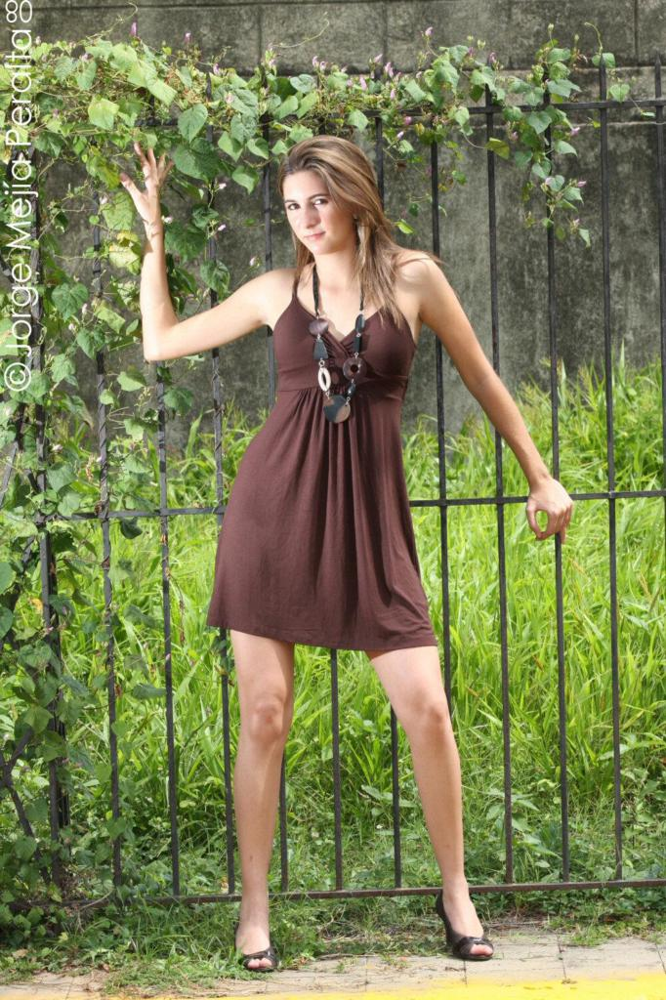

  0%|          | 0/100 [00:00<?, ?it/s]

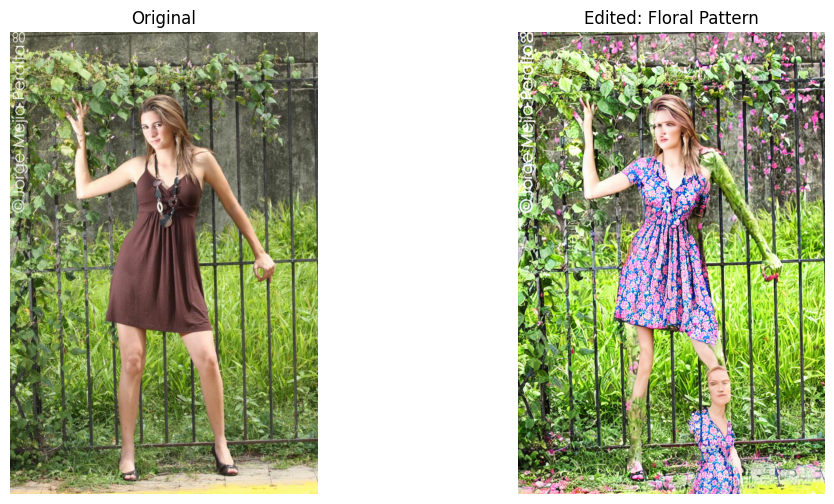

In [ ]:
# --- Load InstructPix2Pix ---
from diffusers import StableDiffusionInstructPix2PixPipeline, DPMSolverMultistepScheduler
from datasets import load_dataset
import torch
import PIL
import matplotlib.pyplot as plt

# Load model
model_id = "timbrooks/instruct-pix2pix"
pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(
    model_id,
    torch_dtype=torch.float16,
    safety_checker=None,
)
pipe.to("cuda")

pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)

# --- Load ONE example from FashionPedia ---
dataset = load_dataset("detection-datasets/fashionpedia", split="train", streaming=True)
first_item = next(iter(dataset))     # get only the FIRST sample

original_image = first_item["image"].convert("RGB")

print("Loaded first FashionPedia image")
display(original_image)

# --- Apply edit ---
prompt = "Give her clothes a floral pattern"

edited = pipe(
    prompt=prompt,
    image=original_image,
    num_inference_steps=100,
    guidance_scale=12,
    image_guidance_scale=2.0,
).images[0]

# --- Show side-by-side ---
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.title("Original")
plt.imshow(original_image)
plt.axis("off")

plt.subplot(1,2,2)
plt.title("Edited: Floral Pattern")
plt.imshow(edited)
plt.axis("off")

plt.show()

